## CMPINF - 2100 - Final Project - Supplemental - EDA

## Khan, Rifat 

## A. Motivation (from EDA assignment)

### a. Are you working on a Regression or Classification problem?
This assignment will be working on a classification problem. 

### b. Which variables are inputs?

The following variables are inputs:

- `playlist_subgenre`
- `danceability`
- `energy`
- `key`
- `loudness`
- `mode`                      
- `speechiness`               
- `acousticness`              
- `instrumentalness`          
- `liveness`                  
- `valence`                   
- `tempo`                     
- `duration_ms`       


### c. Which variables are responses/outputs/outcomes/targets?

The track popularity is the output/ outcome variable.

### d/e. Did you need to DERIVE the responses of interest by SUMMARIZING the availible data? If so what summary actions did you perform?

Yes, the outcome variable `population_label` was derived for simiplicity exploration purposes. The track popularity was split into 2 values, with a popularity greater than 50 being high popularity and a popularity lower than 50 being a low popularity.

### f. Which variables are identifiers and should NOT be used in the models?

The following were considered identifiers and not used in the models:
- `track_id`
- `track_name`
- `track_artist`
- `track_album_id`
- `track_album_name`
- `playlist_name`
- `playlist_id `              


### g. Which of the inputs do you think influence the response, based on your exploratory visualizations? Which exploratory visualization helped you identify potential input-to-output relationships? 

From preliminary analysis, it was hard to determine which variables influenced the response for a binary classification of track popularity. A regression may be needed to be performed to determine which variables influence track popularity. Another potential change needed to be perfomed is to divide up the track popularity into smaller ranges.

## B. Exploratory Data Analysis

## Import Modules

In [173]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

## a. Read data

Load data into notebook

In [174]:
songs_url = 'https://raw.githubusercontent.com/rfordatascience/tidytuesday/master/data/2020/2020-01-21/spotify_songs.csv'

In [175]:
df = pd.read_csv( songs_url )

In [176]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32833 entries, 0 to 32832
Data columns (total 23 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   track_id                  32833 non-null  object 
 1   track_name                32828 non-null  object 
 2   track_artist              32828 non-null  object 
 3   track_popularity          32833 non-null  int64  
 4   track_album_id            32833 non-null  object 
 5   track_album_name          32828 non-null  object 
 6   track_album_release_date  32833 non-null  object 
 7   playlist_name             32833 non-null  object 
 8   playlist_id               32833 non-null  object 
 9   playlist_genre            32833 non-null  object 
 10  playlist_subgenre         32833 non-null  object 
 11  danceability              32833 non-null  float64
 12  energy                    32833 non-null  float64
 13  key                       32833 non-null  int64  
 14  loudne

Let's print the first 5 rows to see the data.

In [177]:
df.head()

,track_id,track_name,track_artist,track_popularity,track_album_id,track_album_name,track_album_release_date,playlist_name,playlist_id,playlist_genre,...,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms
0,6f807x0ima9a1j3VPbc7VN,I Don't Care (with Justin Bieber) - Loud Luxur...,Ed Sheeran,66,2oCs0DGTsRO98Gh5ZSl2Cx,I Don't Care (with Justin Bieber) [Loud Luxury...,2019-06-14,Pop Remix,37i9dQZF1DXcZDD7cfEKhW,pop,...,6,-2.634,1,0.0583,0.1020,0.000000,0.0653,0.518,122.036,194754
1,0r7CVbZTWZgbTCYdfa2P31,Memories - Dillon Francis Remix,Maroon 5,67,63rPSO264uRjW1X5E6cWv6,Memories (Dillon Francis Remix),2019-12-13,Pop Remix,37i9dQZF1DXcZDD7cfEKhW,pop,...,11,-4.969,1,0.0373,0.0724,0.004210,0.3570,0.693,99.972,162600
2,1z1Hg7Vb0AhHDiEmnDE79l,All the Time - Don Diablo Remix,Zara Larsson,70,1HoSmj2eLcsrR0vE9gThr4,All the Time (Don Diablo Remix),2019-07-05,Pop Remix,37i9dQZF1DXcZDD7cfEKhW,pop,...,1,-3.432,0,0.0742,0.0794,0.000023,0.1100,0.613,124.008,176616
3,75FpbthrwQmzHlBJLuGdC7,Call You Mine - Keanu Silva Remix,The Chainsmokers,60,1nqYsOef1yKKuGOVchbsk6,Call You Mine - The Remixes,2019-07-19,Pop Remix,37i9dQZF1DXcZDD7cfEKhW,pop,...,7,-3.778,1,0.1020,0.0287,0.000009,0.2040,0.277,121.956,169093
4,1e8PAfcKUYoKkxPhrHqw4x,Someone You Loved - Future Humans Remix,Lewis Capaldi,69,7m7vv9wlQ4i0LFuJiE2zsQ,Someone You Loved (Future Humans Remix),2019-03-05,Pop Remix,37i9dQZF1DXcZDD7cfEKhW,pop,...,1,-4.672,1,0.0359,0.0803,0.000000,0.0833,0.725,123.976,189052


### b. Number of rows and columns, data types, column names, missing values, unique values

In [178]:
df.shape

(32833, 23)

For this dataset, there are 32833 rows and 23 columns.

Now lets check the column names and there data types

In [179]:
df.dtypes

track_id                     object
track_name                   object
track_artist                 object
track_popularity              int64
track_album_id               object
track_album_name             object
track_album_release_date     object
playlist_name                object
playlist_id                  object
playlist_genre               object
playlist_subgenre            object
danceability                float64
energy                      float64
key                           int64
loudness                    float64
mode                          int64
speechiness                 float64
acousticness                float64
instrumentalness            float64
liveness                    float64
valence                     float64
tempo                       float64
duration_ms                   int64
dtype: object

There are a number of unique identifiers such as `track_id`, `track_album_id`, and `playlist_id`. These values will not directly be used as inputs, however we may need to manipulate these values later on. 

First, lets see the number of unique values and the number of missing values.

In [180]:
df.nunique()

track_id                    28356
track_name                  23449
track_artist                10692
track_popularity              101
track_album_id              22545
track_album_name            19743
track_album_release_date     4530
playlist_name                 449
playlist_id                   471
playlist_genre                  6
playlist_subgenre              24
danceability                  822
energy                        952
key                            12
loudness                    10222
mode                            2
speechiness                  1270
acousticness                 3731
instrumentalness             4729
liveness                     1624
valence                      1362
tempo                       17684
duration_ms                 19785
dtype: int64

In [181]:
df.isna().sum()

track_id                    0
track_name                  5
track_artist                5
track_popularity            0
track_album_id              0
track_album_name            5
track_album_release_date    0
playlist_name               0
playlist_id                 0
playlist_genre              0
playlist_subgenre           0
danceability                0
energy                      0
key                         0
loudness                    0
mode                        0
speechiness                 0
acousticness                0
instrumentalness            0
liveness                    0
valence                     0
tempo                       0
duration_ms                 0
dtype: int64

There appears to be 5 missing values in `track_name`, `track_artist`, and `track_album_name`. Let's check some of these rows.

In [182]:
df[df.isnull().any(axis=1)]

,track_id,track_name,track_artist,track_popularity,track_album_id,track_album_name,track_album_release_date,playlist_name,playlist_id,playlist_genre,...,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms
8151,69gRFGOWY9OMpFJgFol1u0,NaN,NaN,0,717UG2du6utFe7CdmpuUe3,NaN,2012-01-05,HIP&HOP,5DyJsJZOpMJh34WvUrQzMV,rap,...,6,-7.635,1,0.1760,0.0410,0.00000,0.1160,0.649,95.999,282707
9282,5cjecvX0CmC9gK0Laf5EMQ,NaN,NaN,0,3luHJEPw434tvNbme3SP8M,NaN,2017-12-01,GANGSTA Rap,5GA8GDo7RQC3JEanT81B3g,rap,...,11,-5.364,0,0.3190,0.0534,0.00000,0.5530,0.191,146.153,202235
9283,5TTzhRSWQS4Yu8xTgAuq6D,NaN,NaN,0,3luHJEPw434tvNbme3SP8M,NaN,2017-12-01,GANGSTA Rap,5GA8GDo7RQC3JEanT81B3g,rap,...,10,-5.907,0,0.3070,0.0963,0.00000,0.0888,0.505,86.839,206465
19568,3VKFip3OdAvv4OfNTgFWeQ,NaN,NaN,0,717UG2du6utFe7CdmpuUe3,NaN,2012-01-05,Reggaeton viejito🔥,0si5tw70PIgPkY1Eva6V8f,latin,...,11,-6.075,0,0.0366,0.0606,0.00653,0.1030,0.726,97.017,252773
19811,69gRFGOWY9OMpFJgFol1u0,NaN,NaN,0,717UG2du6utFe7CdmpuUe3,NaN,2012-01-05,latin hip hop,3nH8aytdqNeRbcRCg3dw9q,latin,...,6,-7.635,1,0.1760,0.0410,0.00000,0.1160,0.649,95.999,282707


There appears to be duplications in the `track_id`, `playlist_id` and `track_album_id`. Let's see if there are any other duplications.

In [183]:
df.groupby(['track_id', 'track_album_id', 'playlist_id']).size().reset_index(name='num_rows').\
num_rows.value_counts()

num_rows
1    31719
2      482
3       50
Name: count, dtype: int64

According to this, there are 31719 rows which only appears once or are unique. However, there are 482 rows that are exactly the same and appear twice. Even more, there are 50 rows that are exactly the same and appear 3 times!

## Marginal distributions

Let us now take a look at the marginal distributions of each variable. First let's put all the continous variables into long format. 

Let's group these rows together so that there are only unique rows. Additionally, let's create the `df_inputs` dataset for values we will use in our model from the grouped by rows.

NOTE : album release date column was not kept as datetime was not covered in this course and ran into issues of columns not being in yy-mm-dd format.

In [184]:
df_inputs = df.groupby(['track_id'], dropna=False).\
aggregate(playlist_genre = ('playlist_genre', 'first'),
          danceability = ('danceability', 'mean'),
          energy = ('energy', 'mean'),
          key = ('key', 'first'),
          loudness = ('loudness', 'mean'),
          mode = ('mode', 'first'),
          speechiness = ('speechiness', 'mean'),
          acousticness = ('acousticness', 'mean'),
          instrumentalness =('instrumentalness', 'mean'),
          liveness= ('liveness', 'mean'),
          valence = ('valence', 'mean'),
          tempo = ('tempo', 'mean'),
          duration_ms = ('duration_ms', 'mean')).\
reset_index()



In [185]:
df_num = df_inputs.select_dtypes(include=['number'])
df_categorical = df_inputs.select_dtypes(include=['object', 'category'])
df_num.head()

,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms
0,0.682,0.401,2,-10.068,1,0.0236,0.279000,0.011700,0.0887,0.566,97.091,235440.0
1,0.582,0.704,5,-6.242,1,0.0347,0.065100,0.000000,0.2120,0.698,150.863,197286.0
2,0.303,0.880,9,-4.739,1,0.0442,0.011700,0.009940,0.3470,0.404,135.225,373512.0
3,0.659,0.794,10,-5.644,0,0.0540,0.000761,0.132000,0.3220,0.852,128.041,228565.0
4,0.662,0.838,1,-6.300,1,0.0499,0.114000,0.000697,0.0881,0.496,129.884,236308.0


Let's take a look at the marginal distributions for all the numerical data types. First lets transform the data from wide format to long format.

In [186]:
id_cols = ['rowid'] + df_categorical.columns.to_list()
id_cols

['rowid', 'track_id', 'playlist_genre']

In [187]:
songs_lf = df_inputs.reset_index().\
rename(columns={'index': 'rowid'}).\
melt(id_vars=id_cols, value_vars=df_num.columns) 

songs_lf

,rowid,track_id,playlist_genre,variable,value
0,0,0017A6SJgTbfQVU2EtsPNo,rock,danceability,0.682
1,1,002xjHwzEx66OWFV2IP9dk,r&b,danceability,0.582
2,2,004s3t0ONYlzxII9PLgU6z,rock,danceability,0.303
3,3,008MceT31RotUANsKuzy3L,pop,danceability,0.659
4,4,008rk8F6ZxspZT4bUlkIQG,pop,danceability,0.662
...,...,...,...,...,...
340267,28351,7zxRMhXxJMQCeDDg0rKAVo,r&b,duration_ms,179773.000
340268,28352,7zyLObYw4QUKQDyZOb4J0Y,r&b,duration_ms,223890.000
340269,28353,7zycSpvjDcqh6YT1FEl2kY,pop,duration_ms,260240.000
340270,28354,7zye9v6B785eFWEFYs13C2,r&b,duration_ms,191205.000


Now let's plot the distributions for all numerical categories.

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


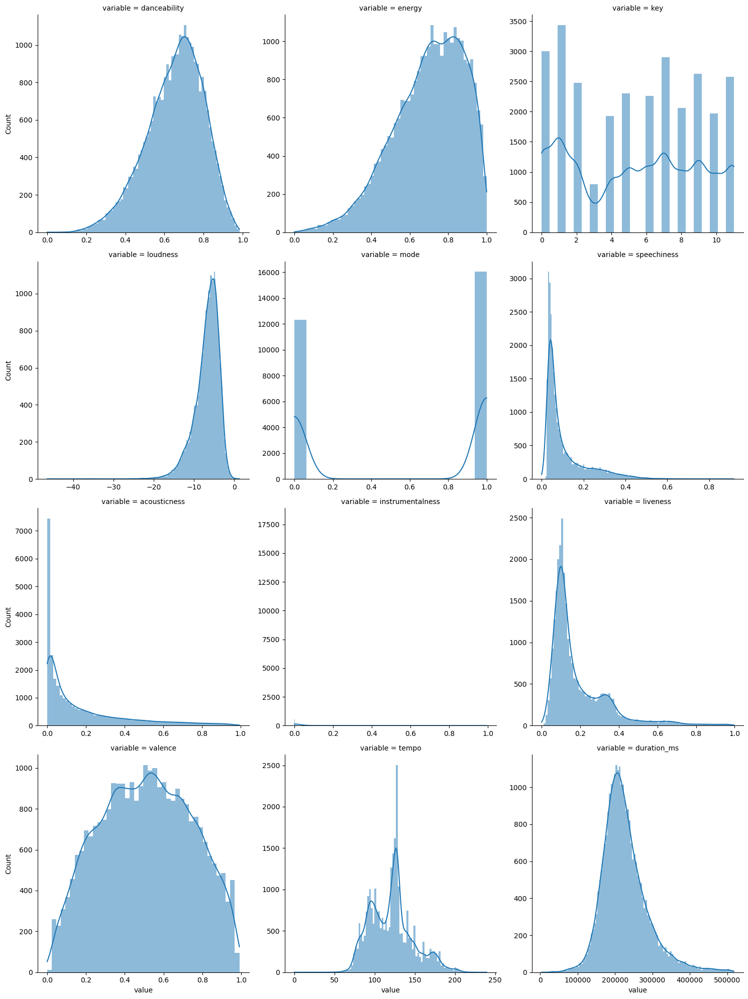

In [188]:
sns.displot(data = songs_lf, kind='hist', x='value', col='variable', kde = True,
            facet_kws= {'sharex': False, 'sharey': False}, col_wrap=3,
            common_bins= False)

plt.show()

From the distribution plots, we can see that `mode` and `key` are categorical variables. Additionally, we can see some inputs with a normal distribution, some skewed to the left and some skewed to the right. Lets change these to categoricals.


In [189]:
df_inputs['mode'] = df_inputs['mode'].astype('category')
df_inputs['key'] = df_inputs['key'].astype('category')

In [190]:
df_num = df_inputs.select_dtypes(include=['number'])
df_categorical = df_inputs.select_dtypes(include=['object', 'category'])

In [191]:
id_cols = ['rowid'] + df_categorical.columns.to_list()
id_cols

['rowid', 'track_id', 'playlist_genre', 'key', 'mode']

In [192]:
songs_lf = df_inputs.reset_index().\
rename(columns={'index': 'rowid'}).\
melt(id_vars=id_cols, value_vars=df_num.columns) 

songs_lf

,rowid,track_id,playlist_genre,key,mode,variable,value
0,0,0017A6SJgTbfQVU2EtsPNo,rock,2,1,danceability,0.682
1,1,002xjHwzEx66OWFV2IP9dk,r&b,5,1,danceability,0.582
2,2,004s3t0ONYlzxII9PLgU6z,rock,9,1,danceability,0.303
3,3,008MceT31RotUANsKuzy3L,pop,10,0,danceability,0.659
4,4,008rk8F6ZxspZT4bUlkIQG,pop,1,1,danceability,0.662
...,...,...,...,...,...,...,...
283555,28351,7zxRMhXxJMQCeDDg0rKAVo,r&b,0,1,duration_ms,179773.000
283556,28352,7zyLObYw4QUKQDyZOb4J0Y,r&b,1,0,duration_ms,223890.000
283557,28353,7zycSpvjDcqh6YT1FEl2kY,pop,2,1,duration_ms,260240.000
283558,28354,7zye9v6B785eFWEFYs13C2,r&b,5,0,duration_ms,191205.000


Now lets check the marginal distribution of the output variable before the conversion to a binary classification.`

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


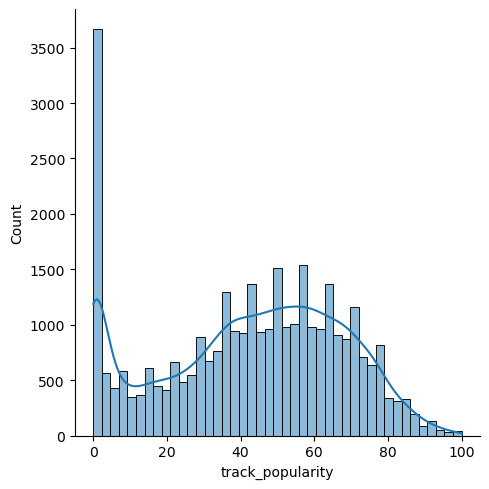

In [193]:
sns.displot(data = df, x='track_popularity', kind='hist', kde=True)

plt.show()

In this project, a clasiffication model will be performed where if a song popularity is above 50, that will be considered highly popular (or `1` for simplicity) and if a song popularity is below the threshold it will be considered not so popular (or `0` for simplicity). 

Let's create this threshold.

In [194]:
popularity_threshold = df.track_popularity.median()
df['popularity_label'] = np.where(df['track_popularity'] >= popularity_threshold, 1, 0)

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


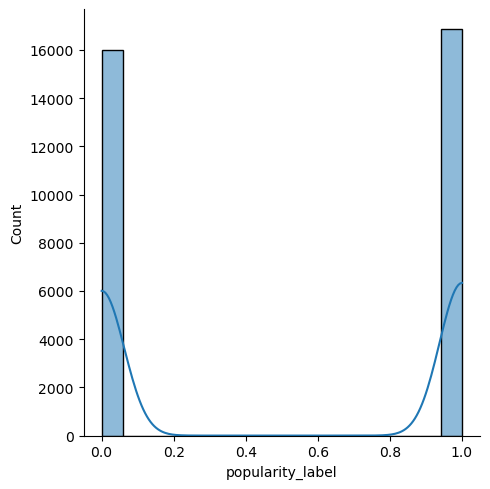

In [195]:
sns.displot(data = df, x='popularity_label', kind='hist', kde=True)

plt.show()

Check the data.

In [196]:
df_inputs.info()
df_inputs.nunique()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28356 entries, 0 to 28355
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype   
---  ------            --------------  -----   
 0   track_id          28356 non-null  object  
 1   playlist_genre    28356 non-null  object  
 2   danceability      28356 non-null  float64 
 3   energy            28356 non-null  float64 
 4   key               28356 non-null  category
 5   loudness          28356 non-null  float64 
 6   mode              28356 non-null  category
 7   speechiness       28356 non-null  float64 
 8   acousticness      28356 non-null  float64 
 9   instrumentalness  28356 non-null  float64 
 10  liveness          28356 non-null  float64 
 11  valence           28356 non-null  float64 
 12  tempo             28356 non-null  float64 
 13  duration_ms       28356 non-null  float64 
dtypes: category(2), float64(10), object(2)
memory usage: 2.7+ MB


track_id            28356
playlist_genre          6
danceability          897
energy               1024
key                    12
loudness            10323
mode                    2
speechiness          1334
acousticness         3812
instrumentalness     4777
liveness             1695
valence              1439
tempo               17762
duration_ms         19785
dtype: int64

All the numeric data types (int64 and float64) were kept in the data along with other columns deemed to potentially affect the model such as `playlist_genre`, `track_album_name` and `track_album_release_date`. Other columns were not included in the new pandas dataframe as they are deemed to be identifiers rather than features that could affect the track popularity. Additionally `track_popularity` was taken out as this is going to be the expected output of the model.

Now let's do some extra cleaning. First we can see that the `key` and `mode` objecct are numerical data types. However if we look at their unique values below and plot the values, we can see they are categorical. First lets check the marginal distirbution of these variables and visualize the categorical-categorical relationships.

### Categorical-Categorical Relationships

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


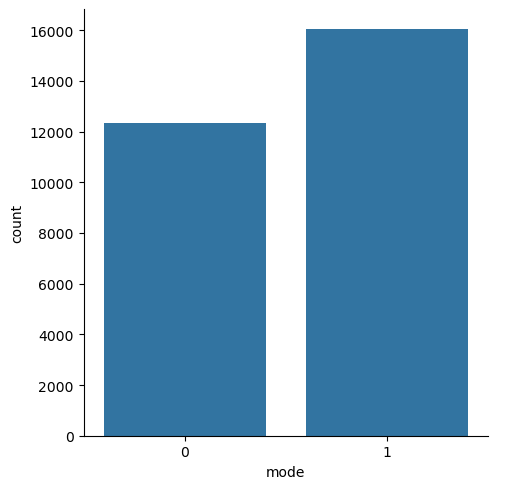

In [197]:
sns.catplot(data= df_inputs, x='mode', kind='count')

plt.show()

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


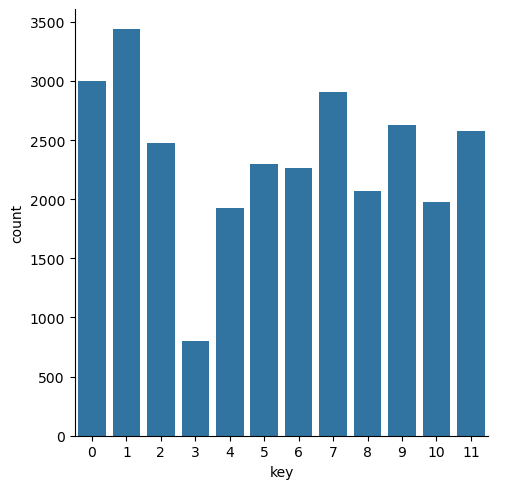

In [198]:
sns.catplot(data= df_inputs, x='key', kind='count')

plt.show()

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


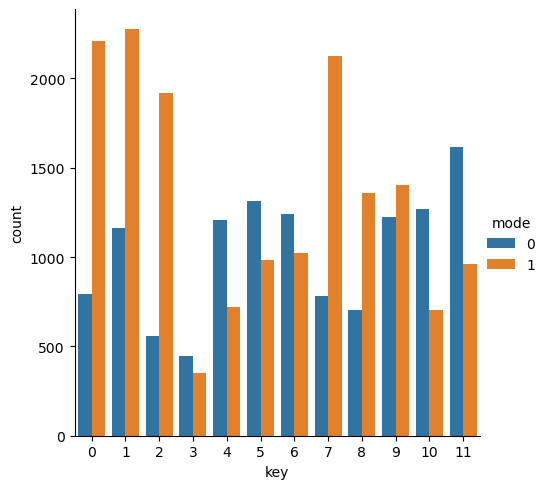

In [199]:
sns.catplot(data= df_inputs, x='key', kind='count', hue='mode')

plt.show()

Let's convert these to categoricals

In [200]:
df_inputs['mode'] = df_inputs['mode'].astype('category')
df_inputs['key'] = df_inputs['key'].astype('category')

In [201]:
df_inputs.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28356 entries, 0 to 28355
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype   
---  ------            --------------  -----   
 0   track_id          28356 non-null  object  
 1   playlist_genre    28356 non-null  object  
 2   danceability      28356 non-null  float64 
 3   energy            28356 non-null  float64 
 4   key               28356 non-null  category
 5   loudness          28356 non-null  float64 
 6   mode              28356 non-null  category
 7   speechiness       28356 non-null  float64 
 8   acousticness      28356 non-null  float64 
 9   instrumentalness  28356 non-null  float64 
 10  liveness          28356 non-null  float64 
 11  valence           28356 non-null  float64 
 12  tempo             28356 non-null  float64 
 13  duration_ms       28356 non-null  float64 
dtypes: category(2), float64(10), object(2)
memory usage: 2.7+ MB


Now let's see the data across `playlist_genre`.

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


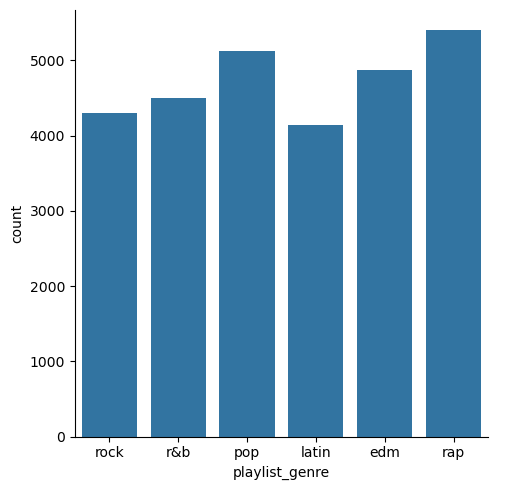

In [202]:
sns.catplot(data= df_inputs, x='playlist_genre', kind='count')

plt.show()

Let's look at the combination of categorical-categorical relationships. 

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


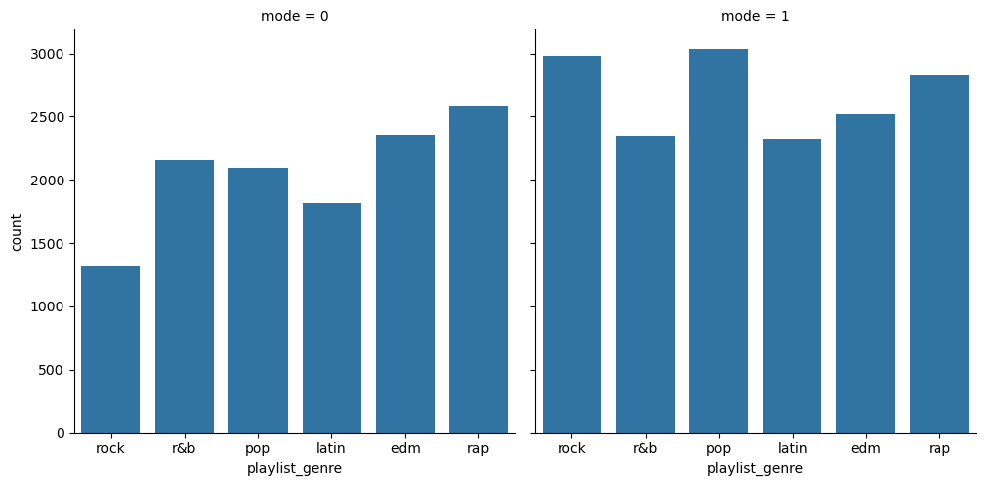

In [203]:
sns.catplot(data= df_inputs, x='playlist_genre', kind='count', col='mode')

plt.show()

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


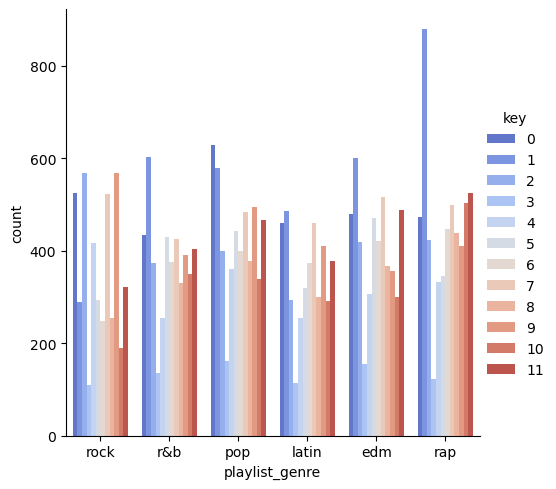

In [204]:
sns.catplot(data= df_inputs, x='playlist_genre', kind='count', hue='key',palette='coolwarm')

plt.show()

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


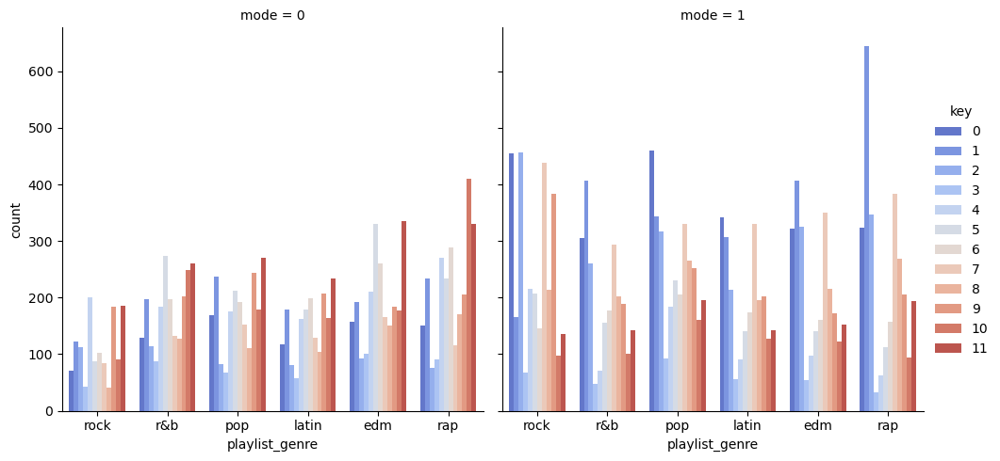

In [205]:
sns.catplot(data= df_inputs, x='playlist_genre', kind='count', hue='key', col='mode',palette='coolwarm')

plt.show()

There appears to be more tracks in higher key's when the mode is 0 and vice-versa. Now lets group them with the outcome.

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


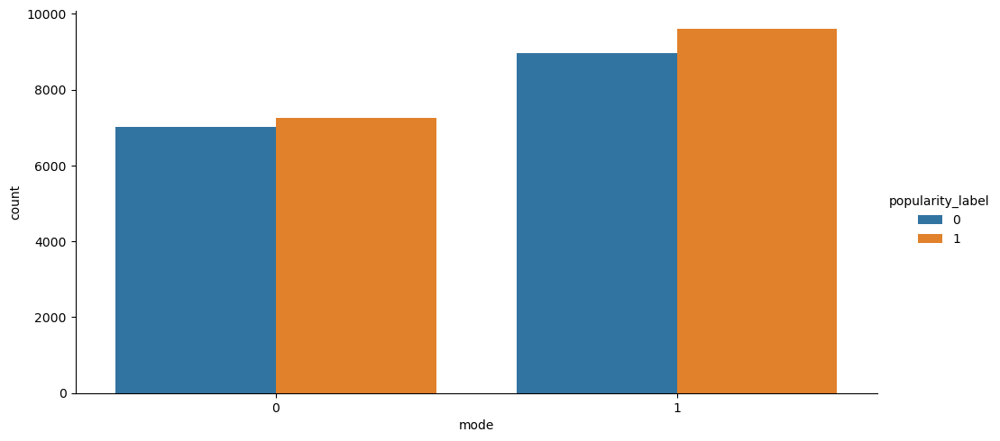

In [206]:
sns.catplot(data = df, x='mode', hue='popularity_label', kind='count', aspect = 2)

plt.show()

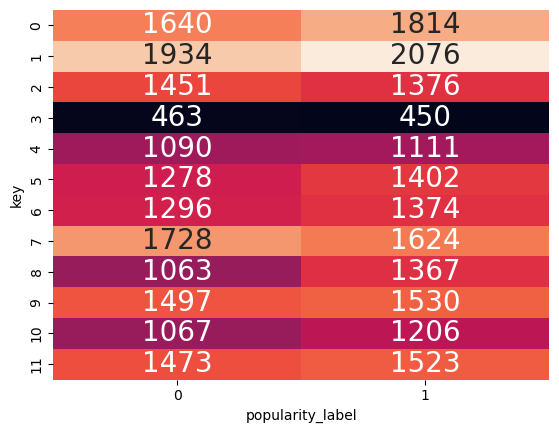

In [207]:
fig, ax = plt.subplots()

sns.heatmap( pd.crosstab( df.key, df.popularity_label), ax = ax,
             annot=True, annot_kws={'size': 20}, fmt='d',
             cbar=False)

plt.show()

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


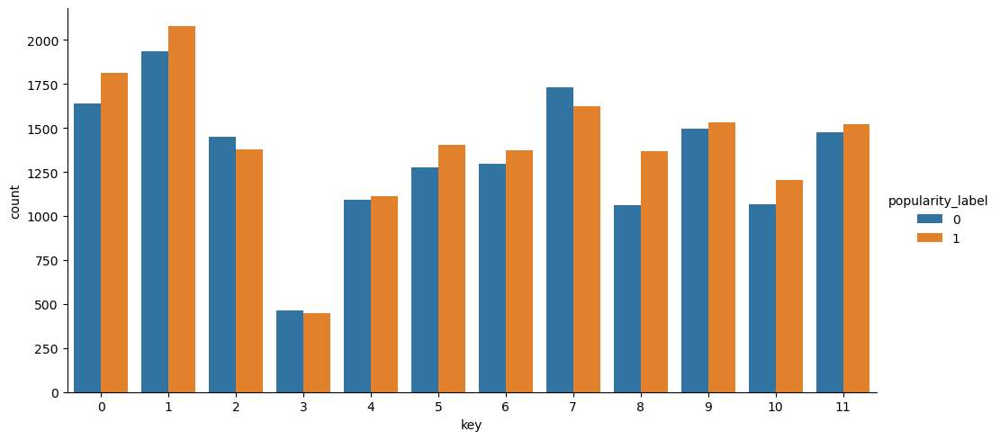

In [208]:
sns.catplot(data = df, x='key', hue='popularity_label', kind='count', aspect = 2)

plt.show()

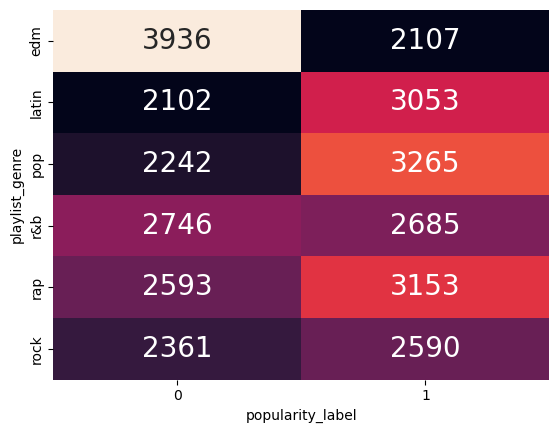

In [209]:
fig, ax = plt.subplots()

sns.heatmap( pd.crosstab( df.playlist_genre, df.popularity_label), ax = ax,
             annot=True, annot_kws={'size': 20}, fmt='d',
             cbar=False)

plt.show()

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


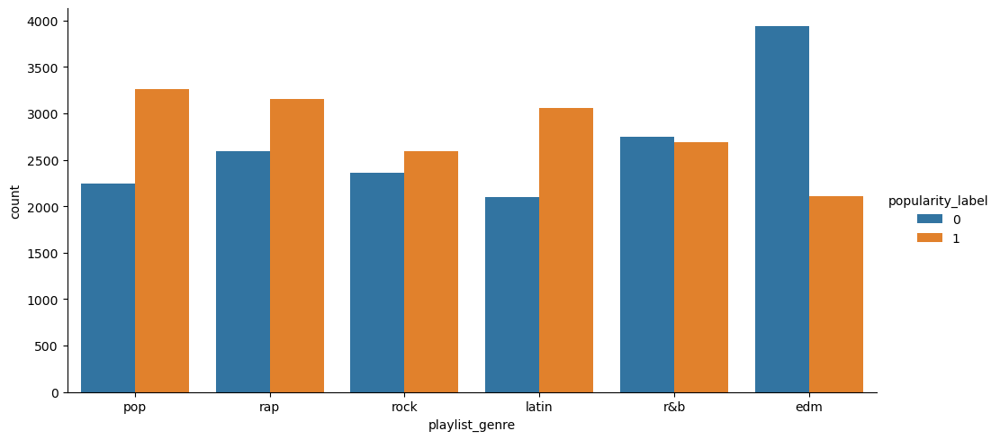

In [210]:
sns.catplot(data = df, x='playlist_genre', hue='popularity_label', kind='count', aspect = 2)

plt.show()

EDM is very unpopular, and has the largest discrepency against its popular songs among playlist genres compared to the other genres.

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


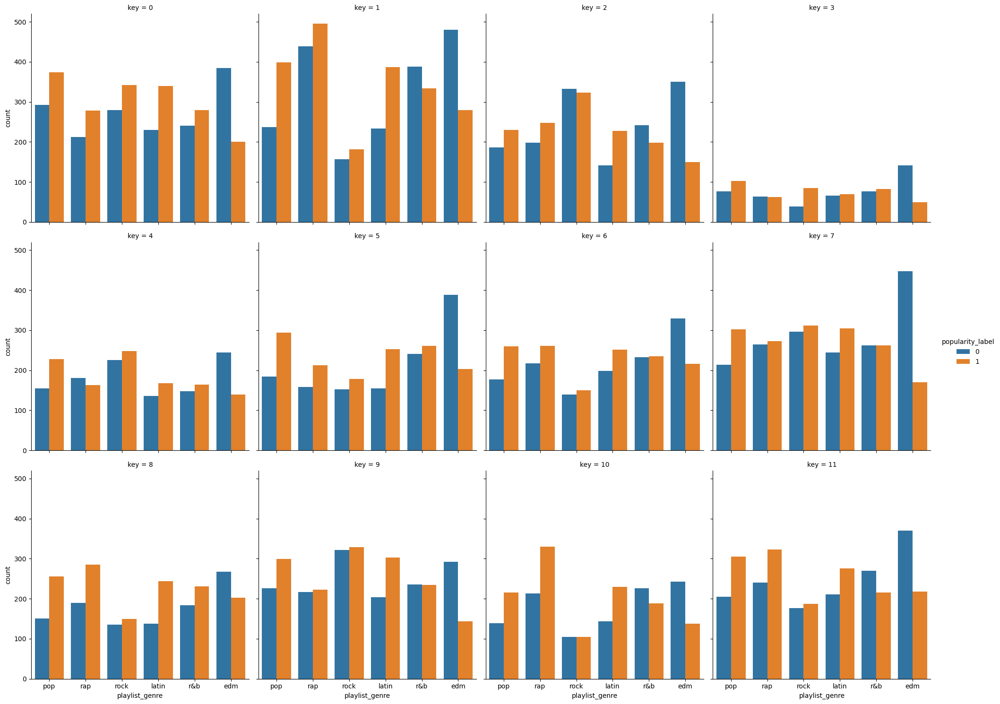

In [211]:
sns.catplot(data = df, x='playlist_genre', hue='popularity_label', col='key', kind='count', col_wrap = 4)

plt.show()

There are some key's within the playlist genre that have a low popularity rating than others. For example, rock in key 9 has more lower popular songs than highers vs rock in key 3. Overall, there is a similar trens across the keys for each playlist genre.

Now let's group the numerical inputs and the categorical inputs together. This is done for conversion from wide format to long format and for KMeans clustering that will be performed later 

### Categorical-to-continous relationships

Let's see some of the relationships between categorical and continous values. First lets see the `energy` and the other categoricals.

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


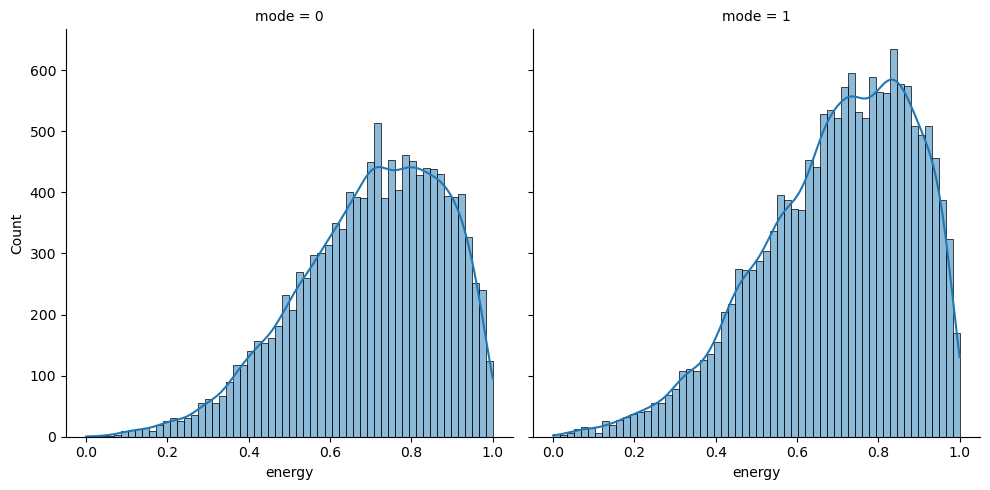

In [212]:
sns.displot(data = df_inputs, x='energy', col='mode', kind='hist', kde=True)

plt.show()

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


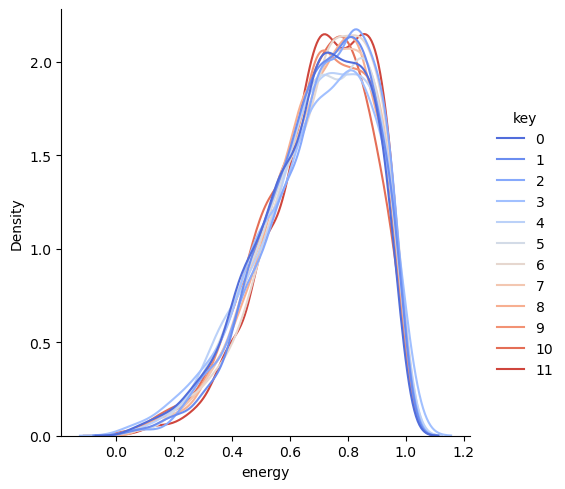

In [213]:
sns.displot(data = df_inputs, x='energy', hue='key', kind='kde', common_norm=False, palette='coolwarm')

plt.show()

/var/folders/2c/j0kw_j7147b6qk3gzzl6cb100000gn/T/ipykernel_38281/3077715761.py:1: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.displot(data = df_inputs, x='energy', col='key', col_wrap=4,
/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


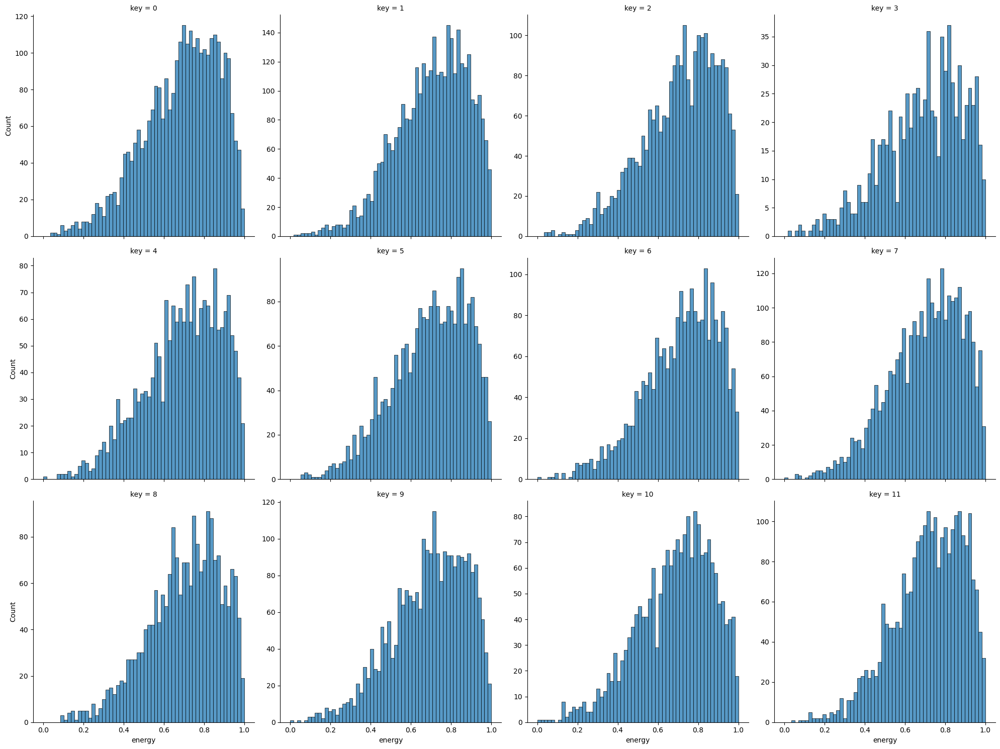

In [214]:
sns.displot(data = df_inputs, x='energy', col='key', col_wrap=4,
            kind='hist',
            facet_kws={'sharex': True, 'sharey': False},
            common_norm=False, palette='coolwarm')

plt.show()

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


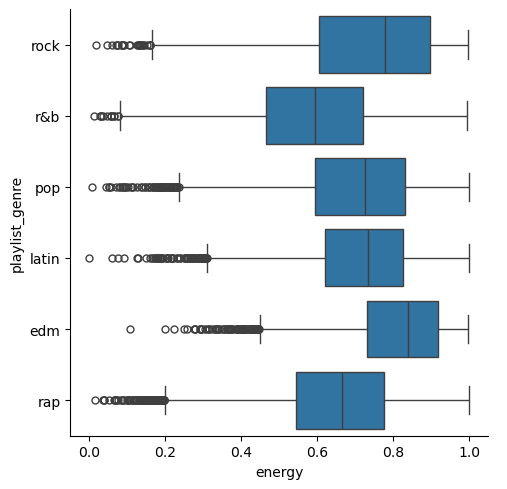

In [215]:
sns.catplot(data = df_inputs, x='energy', y='playlist_genre', 
            kind='box',
            meanprops={'marker': 'o', 'markerfacecolor': 'white', 'markeredgecolor': 'black'})

plt.show()

Based on the boxplotm EDM has the highest average energy. Lets explore `danceability` next.

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


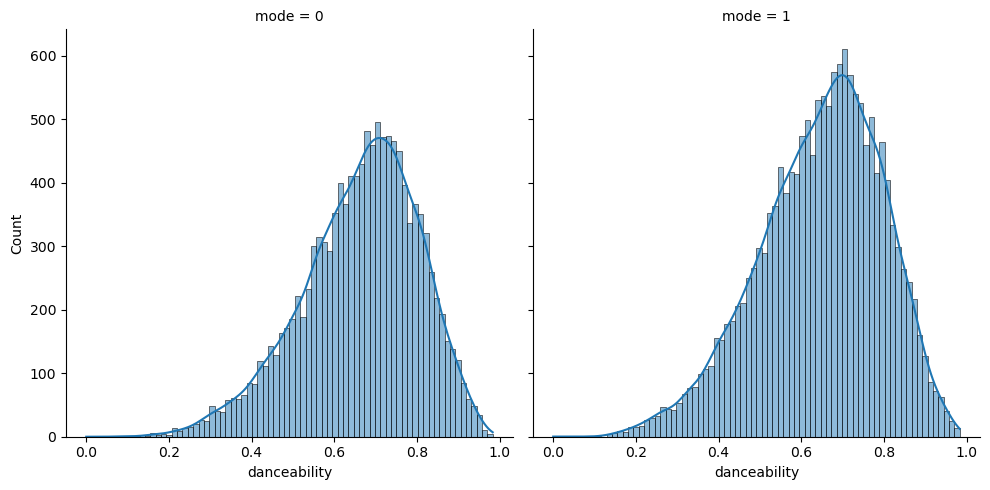

In [216]:
sns.displot(data = df_inputs, x='danceability', col='mode', kind='hist', kde=True)

plt.show()

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


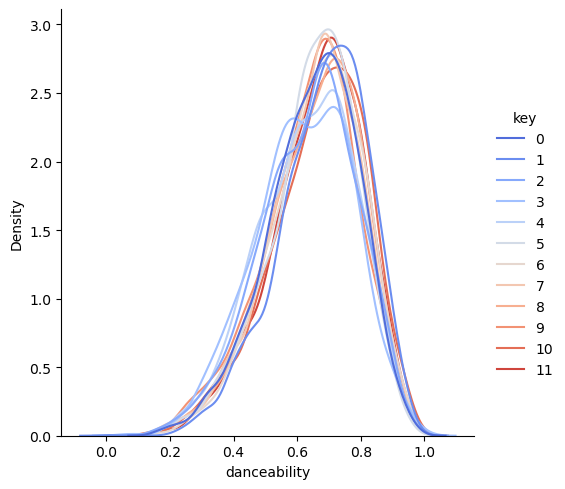

In [217]:
sns.displot(data = df_inputs, x='danceability', hue='key', kind='kde', common_norm=False, palette='coolwarm')

plt.show()

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


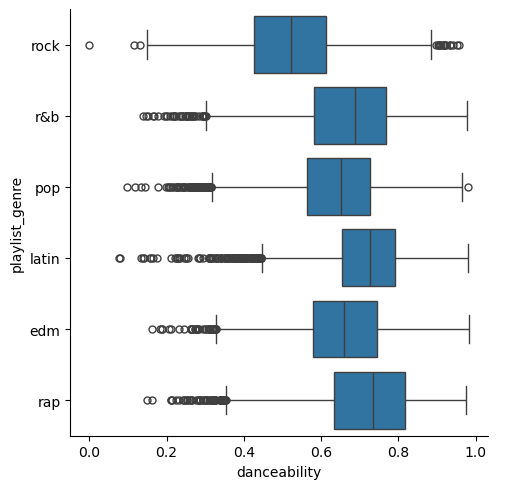

In [218]:
sns.catplot(data = df_inputs, x='danceability', y='playlist_genre', 
            kind='box',
            meanprops={'marker': 'o', 'markerfacecolor': 'white', 'markeredgecolor': 'black'})

plt.show()

Based on the boxplot, rap has the highest average danceability followed by latin. This was suprising as rap is not known to be the most danceable genre. Lets explore the `liveness`.

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


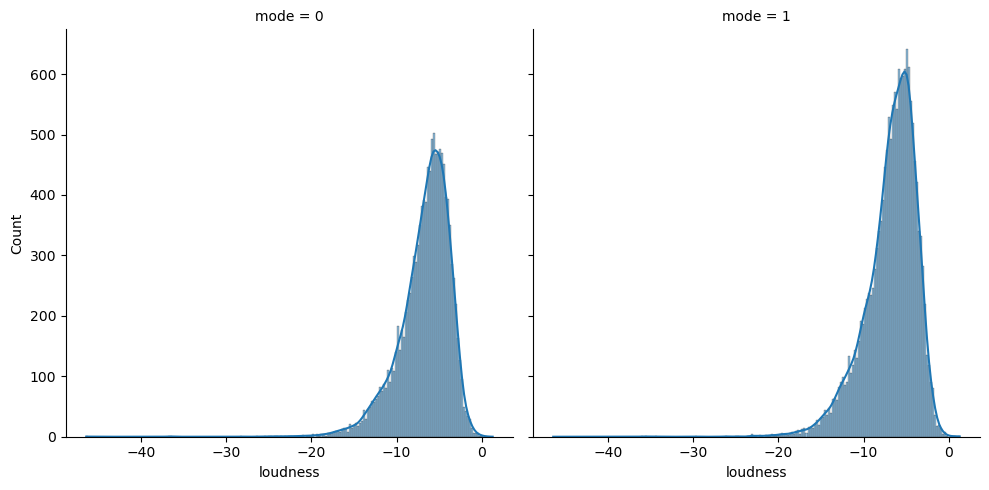

In [219]:
sns.displot(data = df_inputs, x='loudness', col='mode', kind='hist', kde=True)

plt.show()

/var/folders/2c/j0kw_j7147b6qk3gzzl6cb100000gn/T/ipykernel_38281/258573688.py:1: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.displot(data = df_inputs, x='loudness', col='key', col_wrap=4,
/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


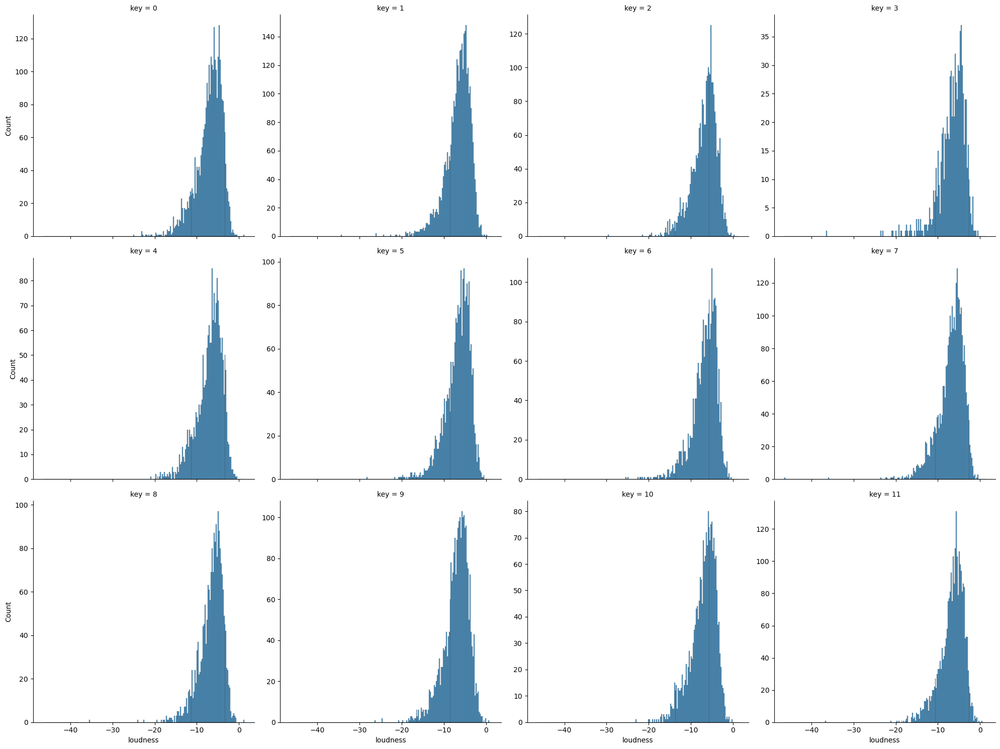

In [220]:
sns.displot(data = df_inputs, x='loudness', col='key', col_wrap=4,
            kind='hist',
            facet_kws={'sharex': True, 'sharey': False},
            common_norm=False, palette='coolwarm')

plt.show()

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


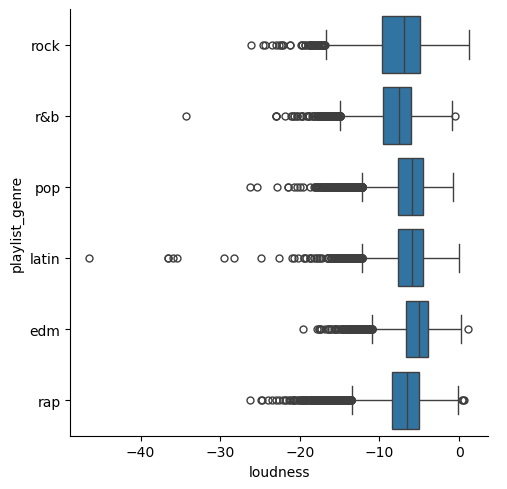

In [221]:
sns.catplot(data = df_inputs, x='loudness', y='playlist_genre', 
            kind='box',
            meanprops={'marker': 'o', 'markerfacecolor': 'white', 'markeredgecolor': 'black'})

plt.show()

Now let's see if theres any relationship when we use a combination of categoricals and continuous variables.

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


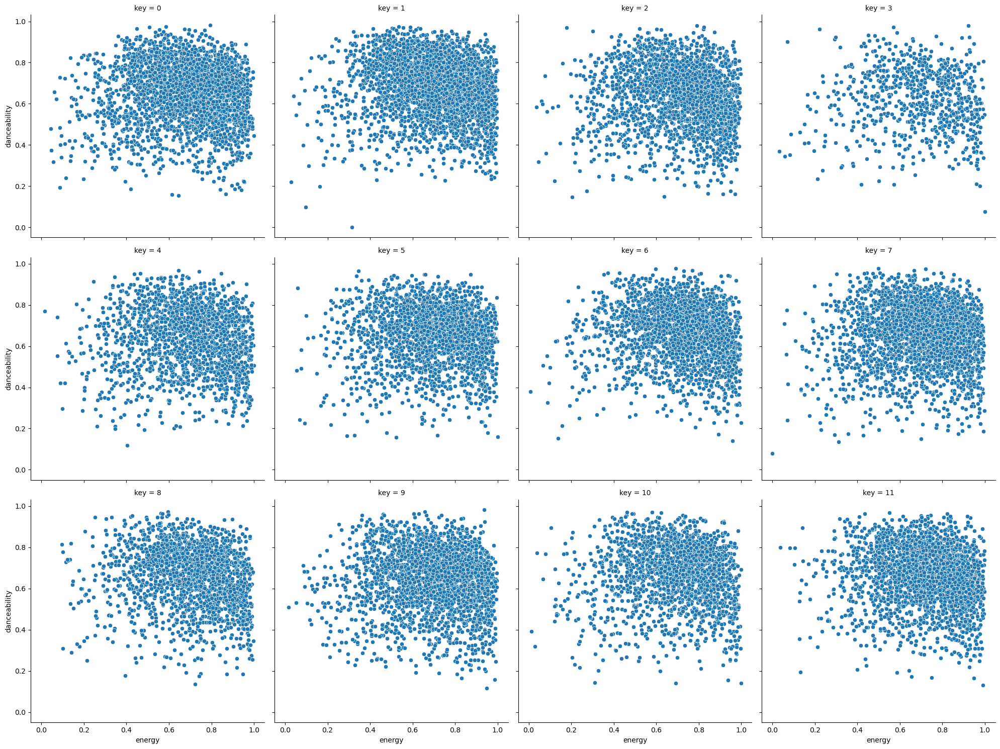

In [222]:
sns.relplot(data = df_inputs, x='energy', y='danceability', col = 'key', col_wrap = 4)

plt.show()

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


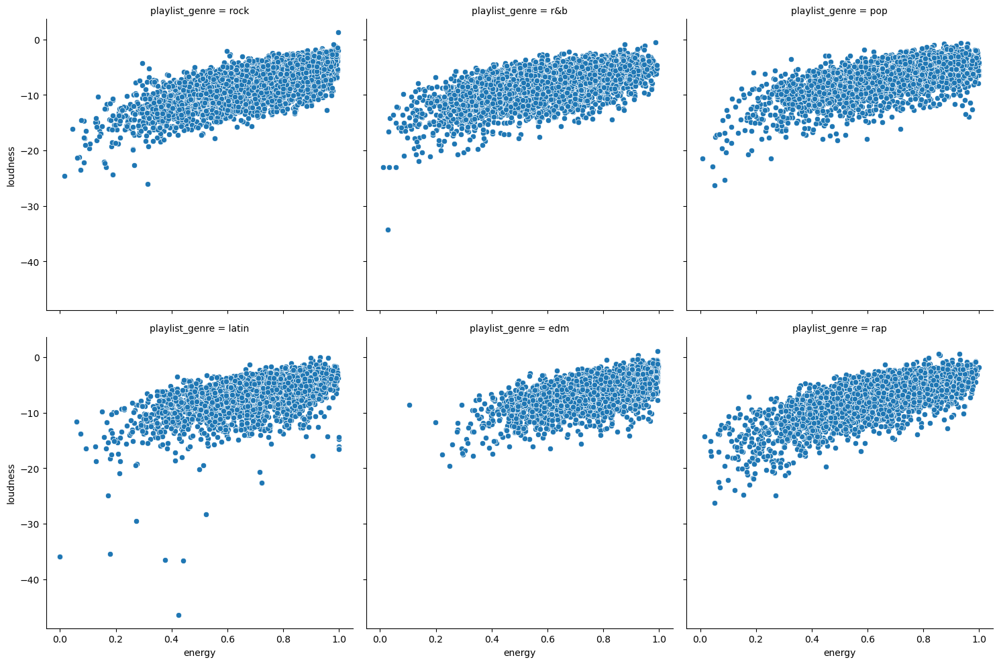

In [223]:
sns.relplot(data = df_inputs, x='energy', y='loudness', col = 'playlist_genre', col_wrap = 3)

plt.show()

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


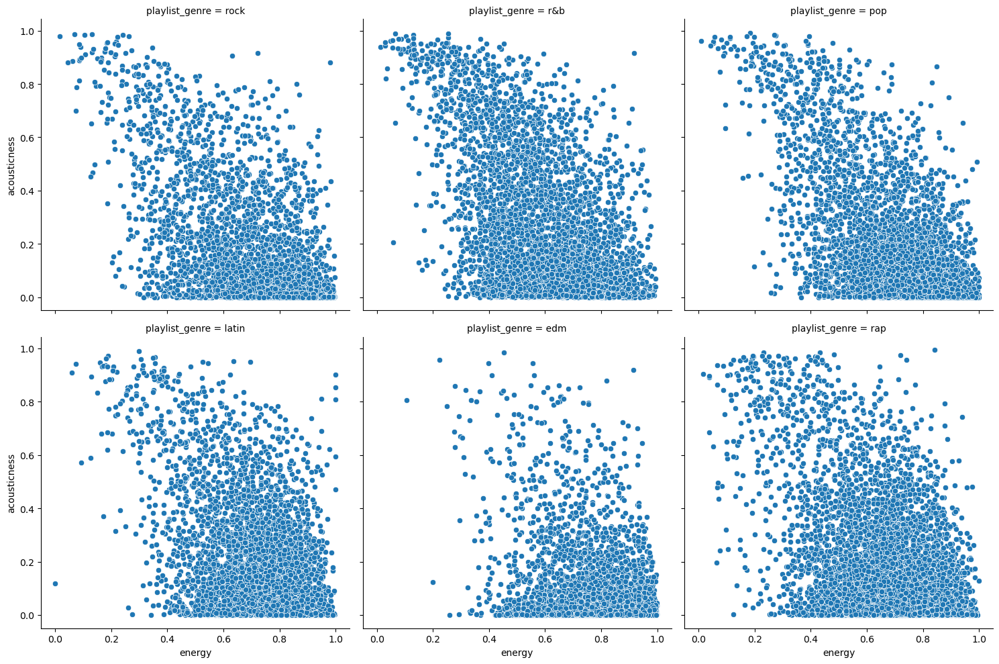

In [224]:
sns.relplot(data = df_inputs, x='energy', y='acousticness', col = 'playlist_genre', col_wrap = 3)

plt.show()

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


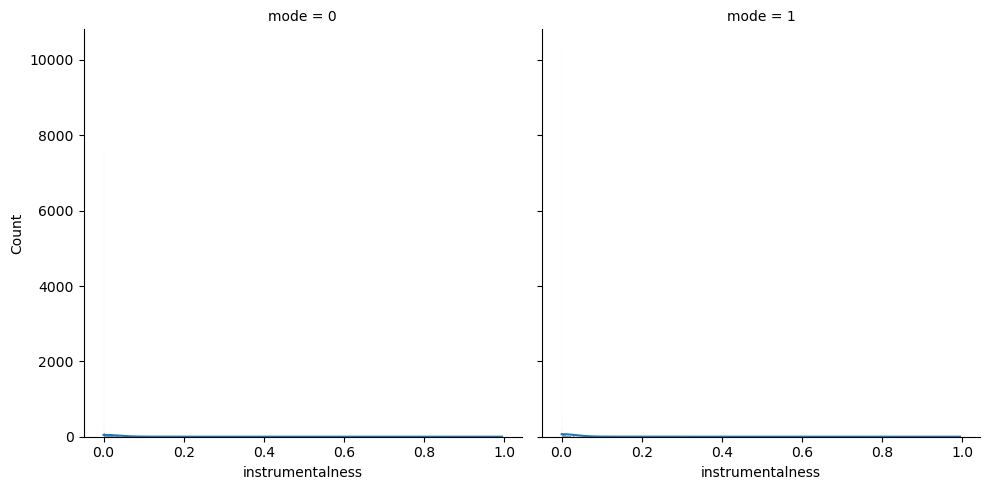

In [225]:
sns.displot(data = df_inputs, x='instrumentalness', col='mode', kind='hist', kde=True)

plt.show()

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


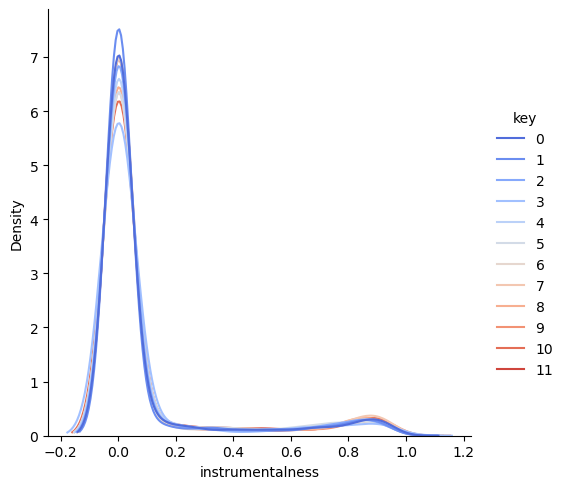

In [226]:
sns.displot(data = df_inputs, x='instrumentalness', hue='key', kind='kde', common_norm=False, palette='coolwarm')

plt.show()

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


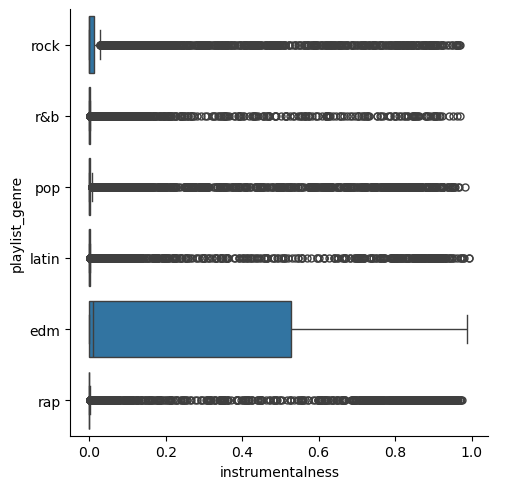

In [227]:
sns.catplot(data = df_inputs, x='instrumentalness', y='playlist_genre', 
            kind='box',
            meanprops={'marker': 'o', 'markerfacecolor': 'white', 'markeredgecolor': 'black'})

plt.show()

EDM has the widest range for instrumentalness. Most of the data seems to be scattered around although there may be a small upward trend with `energy` and `loudness`.

Let's visualize the continous-continous relationships using the `pairplot`.

### Continous-Continous relationships.

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


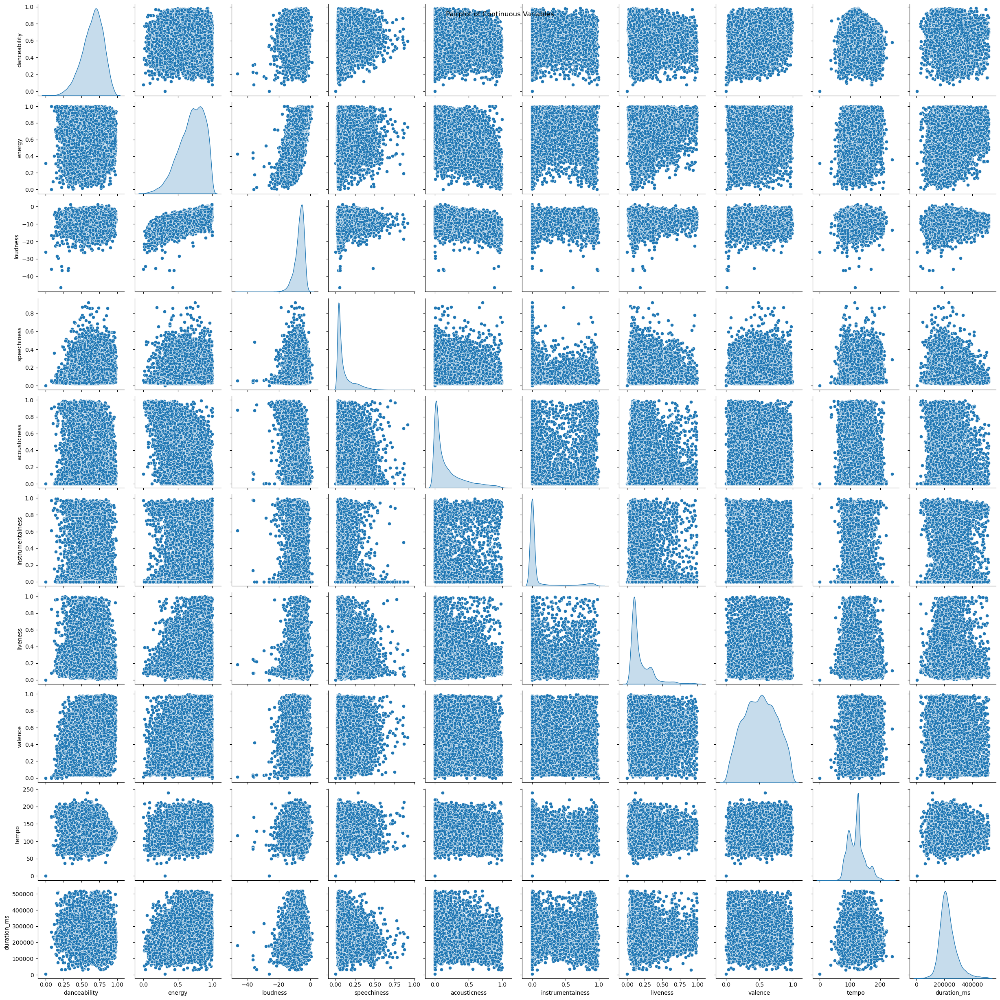

In [228]:
sns.pairplot(df_num, diag_kind='kde')
plt.suptitle('Pairplot of Continuous Variables')
plt.show()

There are many numerical values from the plots above. Let's check to see if there are relaitonships by creating correlation plots from a heatmap.

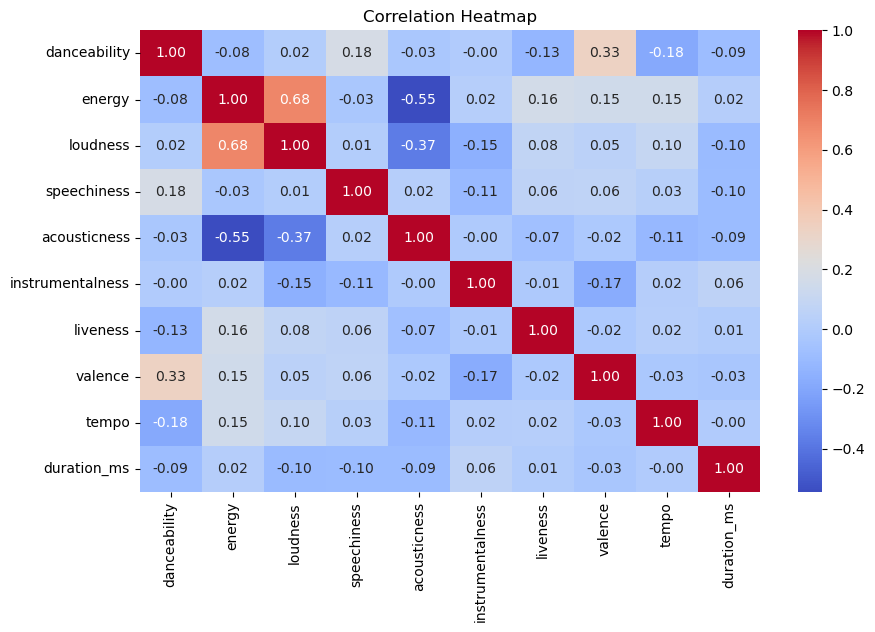

In [229]:
plt.figure(figsize=(10, 6))
sns.heatmap(df_num.corr(), annot=True, cmap='coolwarm', fmt=".2f")
plt.title("Correlation Heatmap")
plt.show()

From the heatmap we can see there are not many values with strong correlation. Loudness and energy have a moderate positive correlation values. Acousticness and energy have a moderate negative correlation value. There may be more trends if we group by the outcome variable.

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


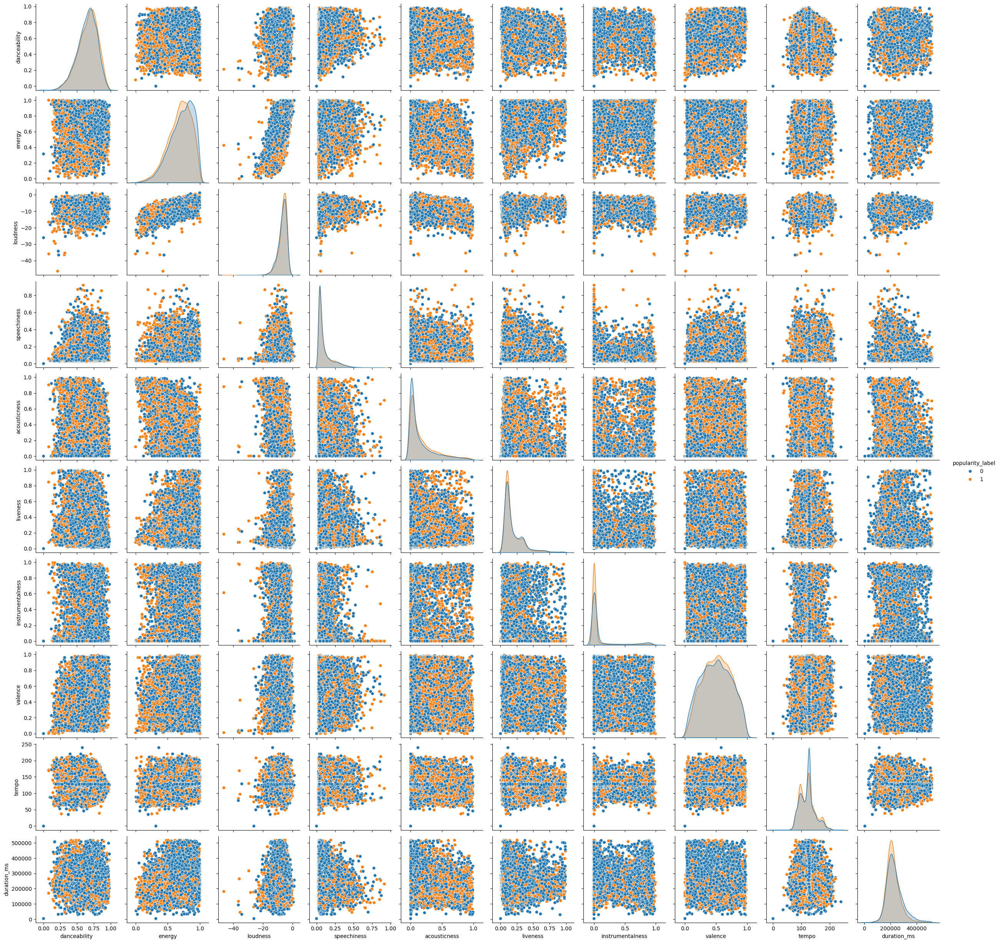

In [230]:
sns.pairplot(df, x_vars = ['danceability', 'energy', 'loudness', 'speechiness', 'acousticness', 
                           'liveness', 'instrumentalness', 'valence','tempo', 'duration_ms'],
            y_vars = ['danceability', 'energy', 'loudness', 'speechiness', 'acousticness', 
                           'liveness', 'instrumentalness', 'valence','tempo', 'duration_ms'],
            hue='popularity_label',
            diag_kws={'common_norm':False})
plt.show()

There does not appear to be any distinct groups when classifying based on the outcome. Let's see if we can make each variable more gaussian like. So far only `danceability`, `valence`, and `duration_ms` are gaussian like. Let's try normalizing the other variables. For left-skewed variables, we will square or cube the value. For right-skew we will use the log tranformation or a root transformation.

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


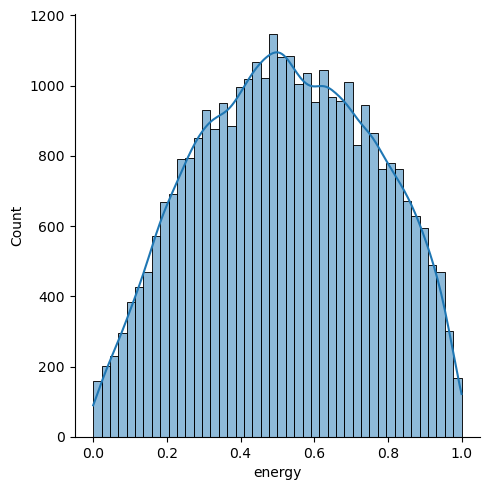

In [231]:
df_copy = df.copy()
df_copy['energy'] = np.power(df_copy.energy, 2)

sns.displot(data = df_copy, x='energy', kind='hist', kde=True)

plt.show()

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


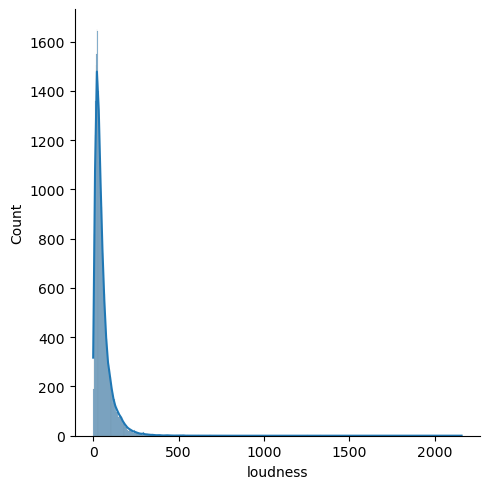

In [232]:
df_copy = df.copy()
df_copy['loudness'] = np.power(df_copy.loudness, 2) 

sns.displot(data = df_copy, x='loudness', kind='hist', kde=True)

plt.show()

`Loudness` Did not become gaussian-like.

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/pandas/core/arraylike.py:396: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


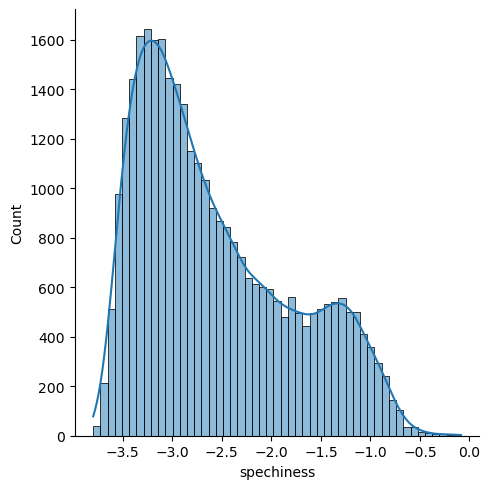

In [233]:
df_copy = df.copy()
df_copy['spechiness'] = np.log(df.speechiness) 

sns.displot(data = df_copy, x='spechiness', kind='hist', kde=True)

plt.show()

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


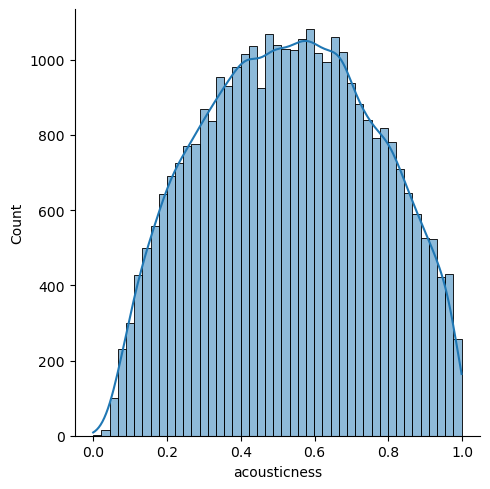

In [234]:
df_copy = df.copy()
df_copy['acousticness'] = np.power(df_copy.acousticness, 1/4) 

sns.displot(data = df_copy, x='acousticness', kind='hist', kde=True)

plt.show()

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/pandas/core/arraylike.py:396: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


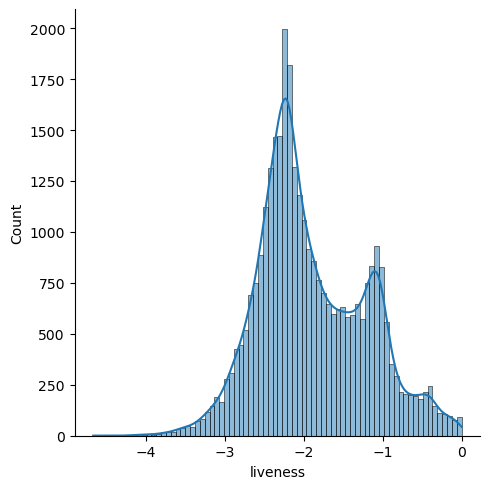

In [235]:
df_copy = df.copy()
df_copy['liveness'] = np.log(df_copy.liveness) 

sns.displot(data = df_copy, x='liveness', kind='hist', kde=True)

plt.show()

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/pandas/core/arraylike.py:396: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


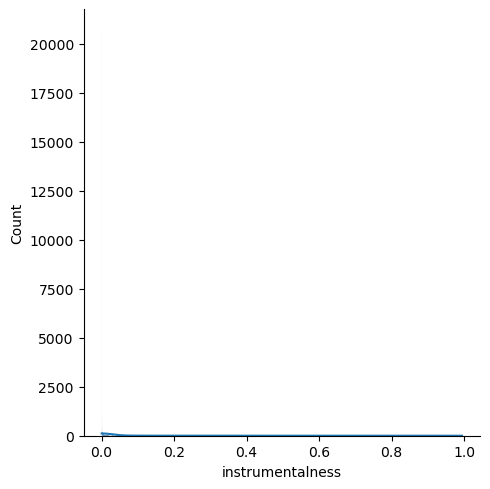

In [236]:
df_copy = df.copy()
df_copy['instrumenalness'] = np.log(df_copy.instrumentalness) 

sns.displot(data = df_copy, x='instrumentalness', kind='hist', kde=True)

plt.show()

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/pandas/core/arraylike.py:396: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


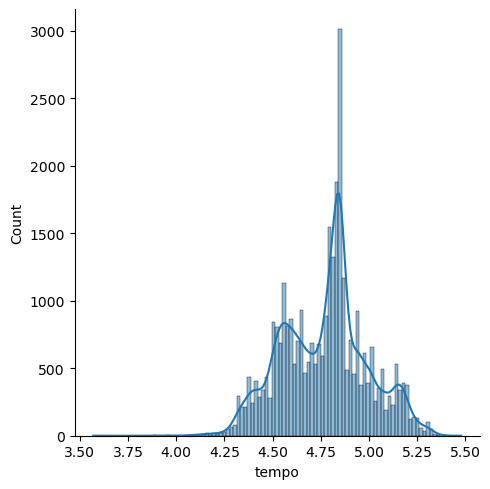

In [237]:
df_copy = df.copy()
df_copy['tempo'] = np.log(df_copy.tempo) 

sns.displot(data = df_copy, x='tempo', kind='hist', kde=True)

plt.show()

`Tempo` does not appear to look more gaussian like after transformations, so this will also be omitted from the model.

Therefore `energy`,`liveness` and `acousticness` look more gaussian like after there respective transformations, joining `danceability`, `valence`, and `durations_ms` as the gaussian like variables.. `Loudness`, `speechinees`, `tempo` and `Instrumentalness` do not look more gaussian even after transforming them. 

This is the end of the EDA portion of the final project. Below is the K-means clustering performed the first time for the EDA assignment.

## Preprocessing

Now let's use the long format data and plot all the numerical variables.

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


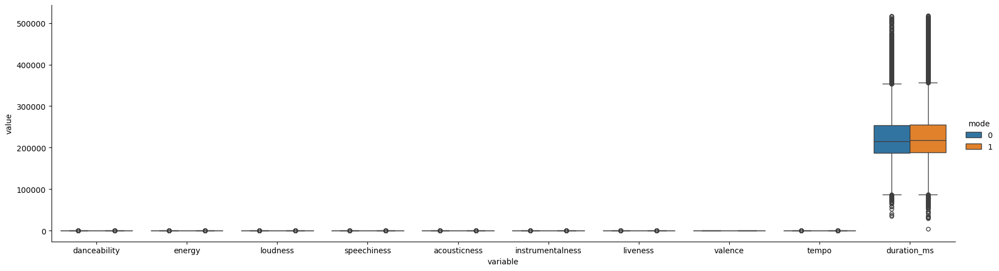

In [238]:
sns.catplot(data = songs_lf, x='variable', y='value', hue = 'mode', kind='box', aspect=3.5)

plt.show()

There is one variable that is much larger in magnitude and scale thus we shall standardize the data using the `StandardScaler()` feature.

In [239]:
X_songs = StandardScaler().fit_transform( df_num)

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


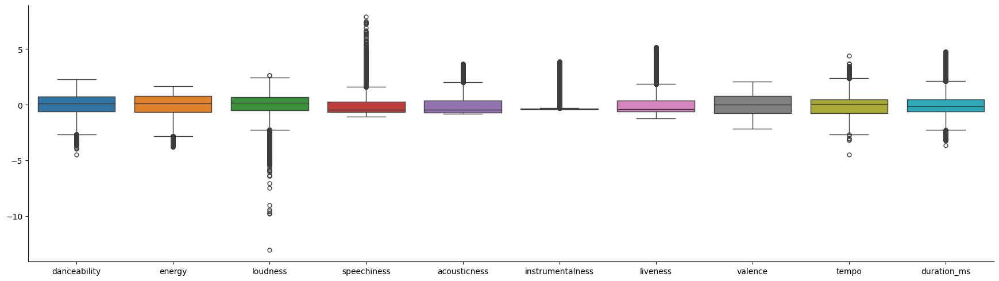

In [240]:
sns.catplot(data = pd.DataFrame(X_songs, columns=df_num.columns), kind='box', aspect=3.5)

plt.show()

## K-Means Cluster Analysis 

The data appears to be standardized. There are 10 variables being used for cluster analysis seen in the box plot above. Total number of observations being used is 28356. 

Only 2 of the variables have somewhat of a gaussian distribution, those being `danceability` and `valence`. 

`energy` and `loudness` are somewhat positively correlated. `energy` and `acousticness` are somewhat negarively correlated.

No values were droped as none of the continous variables contained missing values.

Let's execute cluseter analysis with 2 clusters.

In [241]:
clusters_2 = KMeans(n_clusters=2, random_state= 121, n_init=25, max_iter=500).fit_predict(X_songs)

In [242]:
df_num_copy = df_num.copy()
df_inputs_copy = df_inputs.copy()

In [243]:
df_num_copy['k2'] = pd.Series( clusters_2, index=df_inputs_copy.index).astype('category')

In [244]:
df_num_copy.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28356 entries, 0 to 28355
Data columns (total 11 columns):
 #   Column            Non-Null Count  Dtype   
---  ------            --------------  -----   
 0   danceability      28356 non-null  float64 
 1   energy            28356 non-null  float64 
 2   loudness          28356 non-null  float64 
 3   speechiness       28356 non-null  float64 
 4   acousticness      28356 non-null  float64 
 5   instrumentalness  28356 non-null  float64 
 6   liveness          28356 non-null  float64 
 7   valence           28356 non-null  float64 
 8   tempo             28356 non-null  float64 
 9   duration_ms       28356 non-null  float64 
 10  k2                28356 non-null  category
dtypes: category(1), float64(10)
memory usage: 2.2 MB


In [245]:
df_num_copy.k2.value_counts()

k2
0    19963
1     8393
Name: count, dtype: int64

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


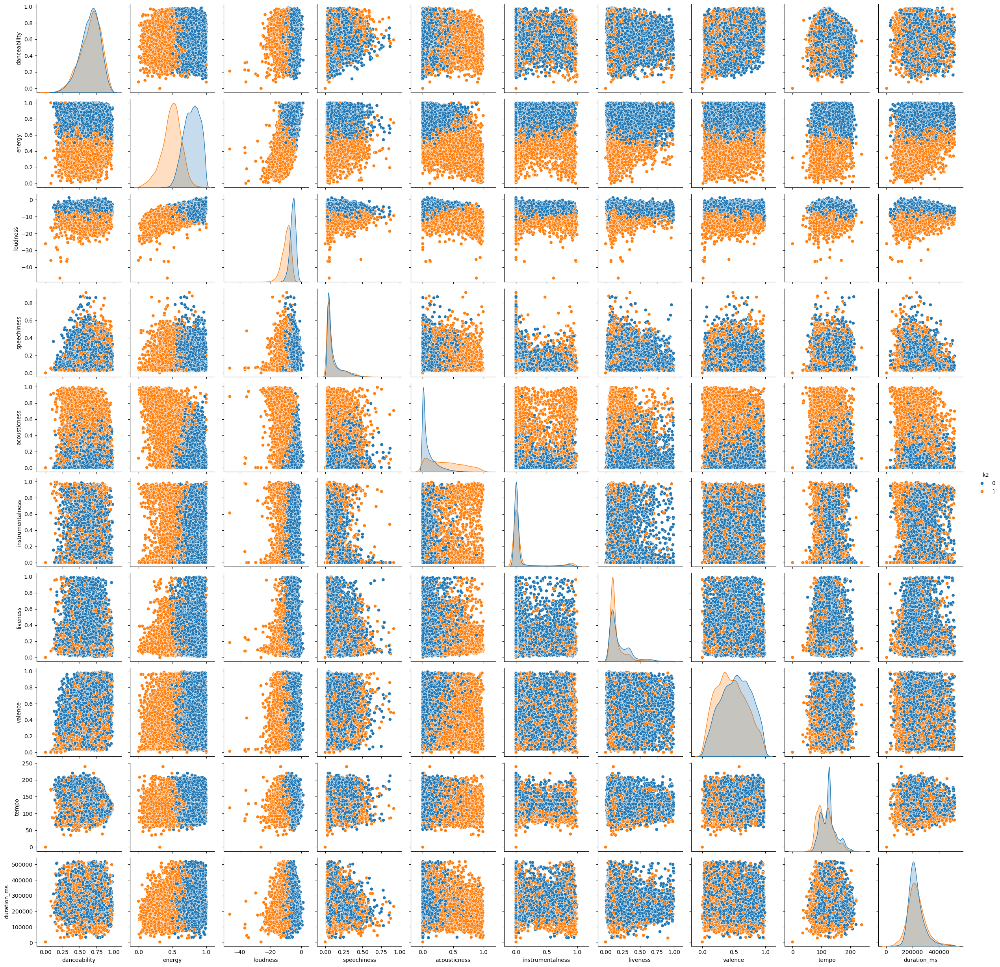

In [246]:
sns.pairplot(data = df_num_copy, hue='k2', diag_kws={'common_norm': False})

plt.show()

Pairsplot shows to many variables so we will execute a PCA. Additionally clusters seem to be balanced in some of the variables such as `energy`, `valence` and `acousticness`.

In [247]:
pca_songs = PCA(n_components=2).fit_transform(X_songs)

In [248]:
pca_songs_df = pd.DataFrame( pca_songs, columns=['pc01', 'pc02']) 

In [249]:
pca_songs_df['k2'] = pd.Series( clusters_2, index=df_num_copy.index).astype('category')

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


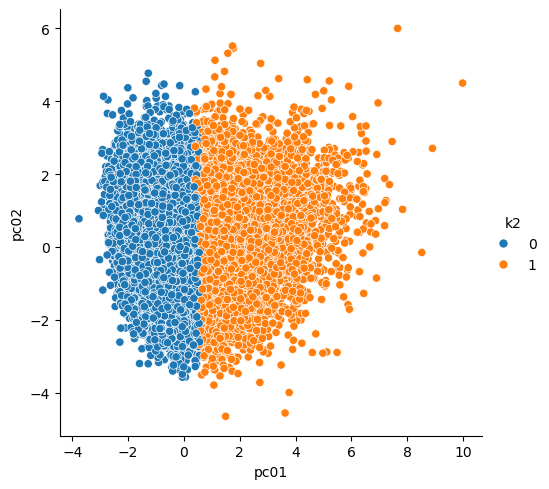

In [250]:
sns.relplot(data = pca_songs_df, x='pc01', y='pc02', hue='k2')

plt.show()

Now let's compare this with the binary classification variable created at the beginning for `popularity_label`.

In [251]:
pca_songs_df['popularity_label'] = df.popularity_label

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


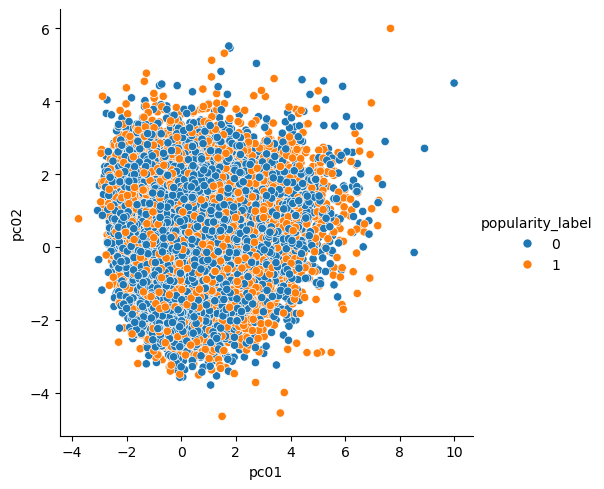

In [252]:
sns.relplot(data = pca_songs_df, x='pc01', y='pc02', hue='popularity_label')

plt.show()

From the plot, we can see that the values are still all over the place. We may need to increase or decrease the threshold for the project in order to get the values more clustered together. Or we may need to increase the `n_components` for PCA or use a different Kmeans method completely.


/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


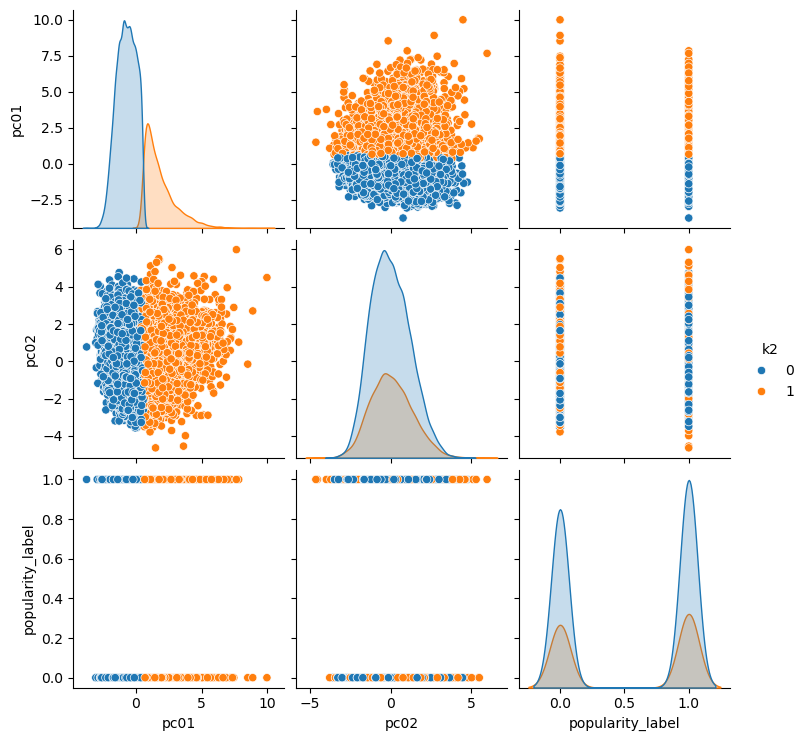

In [253]:
sns.pairplot(data= pca_songs_df, hue='k2')

plt.show()

The pairplot shows the PCA as balanced the values for k2 components. However, when comparing to the popularity label we can see the values are all over the place.

Let's look for the optimal clusters using the Knee bend plot

In [254]:
tots_within = []

K = range(1, 31)

for k in K:
    km = KMeans(n_clusters=k, random_state=121, n_init=25, max_iter=500)
    km = km.fit(X_songs)
    tots_within.append(km.inertia_)

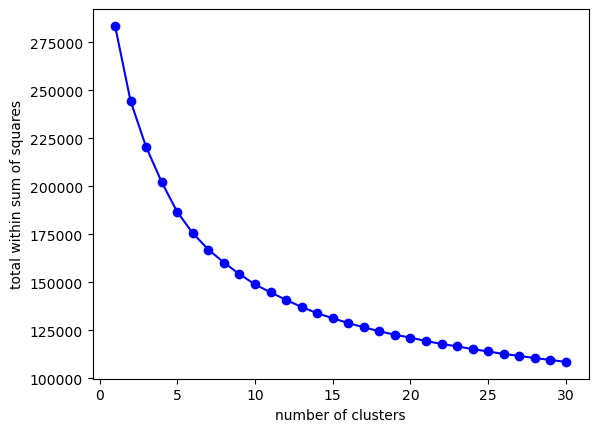

In [255]:
fig, ax = plt.subplots()

ax.plot( K, tots_within, 'bo-')
ax.set_xlabel('number of clusters')
ax.set_ylabel('total within sum of squares')

plt.show() 

From the plot above we can see 10-15 clusters is a decent value to run KMeans clustering. Let's use KMeans with 10 clusters.

In [256]:
clusters_10 = KMeans(n_clusters=10, random_state= 121, n_init=25, max_iter=500).fit_predict(X_songs)

In [257]:
pca_songs_df['k10'] = pd.Series( clusters_10, index=df_num_copy.index).astype('category')

In [258]:
pca_songs_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28356 entries, 0 to 28355
Data columns (total 5 columns):
 #   Column            Non-Null Count  Dtype   
---  ------            --------------  -----   
 0   pc01              28356 non-null  float64 
 1   pc02              28356 non-null  float64 
 2   k2                28356 non-null  category
 3   popularity_label  28356 non-null  int64   
 4   k10               28356 non-null  category
dtypes: category(2), float64(2), int64(1)
memory usage: 720.5 KB


/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


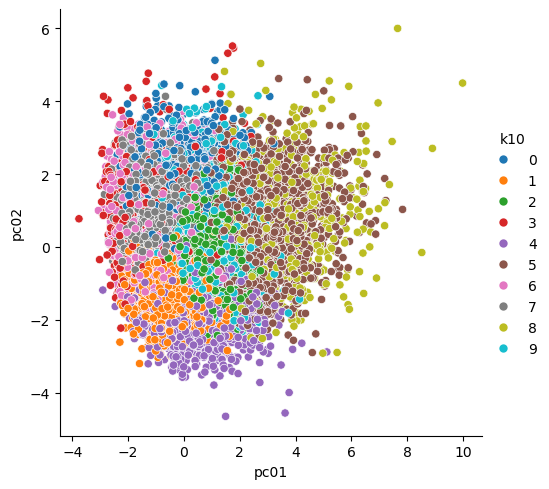

In [259]:
sns.relplot(data = pca_songs_df, x='pc01', y='pc02', hue='k10')

plt.show()

Let's compare this with the outcome variable.

In [260]:
df_num_copy ['popularity_label'] = df.popularity_label
df_num_copy.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28356 entries, 0 to 28355
Data columns (total 12 columns):
 #   Column            Non-Null Count  Dtype   
---  ------            --------------  -----   
 0   danceability      28356 non-null  float64 
 1   energy            28356 non-null  float64 
 2   loudness          28356 non-null  float64 
 3   speechiness       28356 non-null  float64 
 4   acousticness      28356 non-null  float64 
 5   instrumentalness  28356 non-null  float64 
 6   liveness          28356 non-null  float64 
 7   valence           28356 non-null  float64 
 8   tempo             28356 non-null  float64 
 9   duration_ms       28356 non-null  float64 
 10  k2                28356 non-null  category
 11  popularity_label  28356 non-null  int64   
dtypes: category(1), float64(10), int64(1)
memory usage: 2.4 MB


/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


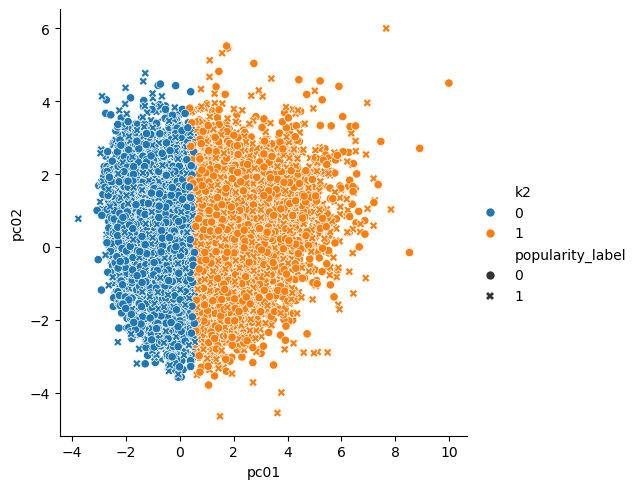

In [261]:
sns.relplot(data = pca_songs_df, x='pc01', y='pc02', hue='k2', style='popularity_label')

plt.show()

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


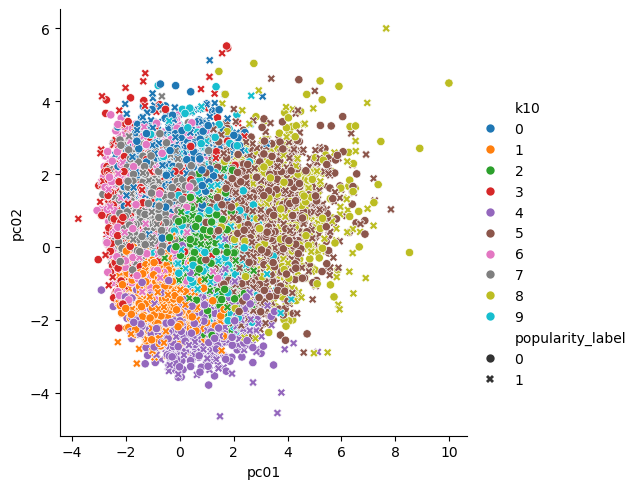

In [262]:
sns.relplot(data = pca_songs_df, x='pc01', y='pc02', hue='k10', style='popularity_label')

plt.show()

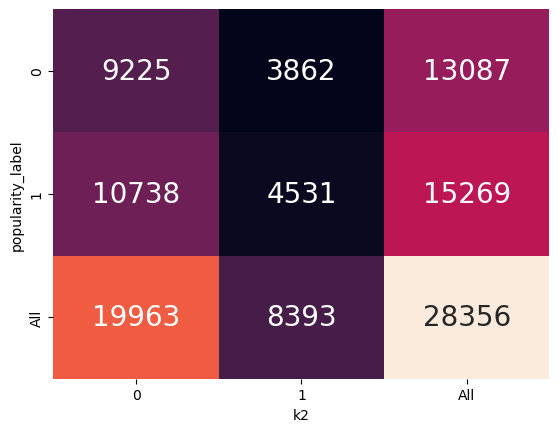

In [263]:
fig, ax = plt.subplots()

sns.heatmap(data = pd.crosstab( df_num_copy.popularity_label, df_num_copy.k2, margins=True ), 
            annot=True, annot_kws={"fontsize": 20}, fmt='g',
            cbar=False,
            ax=ax)

plt.show()

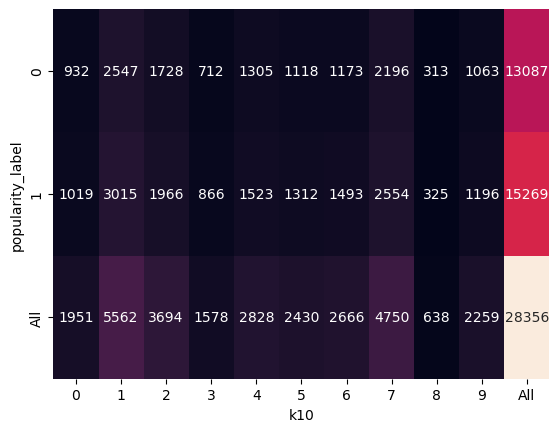

In [264]:
fig, ax = plt.subplots()

sns.heatmap(data = pd.crosstab( pca_songs_df.popularity_label, pca_songs_df.k10, margins=True ), 
            annot=True, annot_kws={"fontsize": 10}, fmt='g',
            cbar=False,
            ax=ax)

plt.show()

## Interpret section

Comparing the popularity label with the k2 kmeans clustering, we can see there were too many songs put into the 0 label or the less popular label and too little put into the 1 label or the more popular label. This means we may need to classify the songs into smaller groups, such as 10 groups. 

Additionally running PCA only for n = 2 components may be too little to run on this dataset. For the final project, we could explore clustering with a higher PCA component value or clustering with summary statistics from the caregoricals.
